<img src="https://raw.githubusercontent.com/AdrianoPereira/CAP421/main/lectures/homework09/images/cover-data-augmentation.png" style="width: 100%;">

### OVERVIEW
<hr />

This notebook contains exercise 09 which deals with some data augmentation techniques for machine learning. This exercise was proposed by Professor Thales Körting in the discipline CAP421 - Deep Learning offered in the Graduate Program in Applied Computing at the National Institute for Space Research.

#### TABLE OF CONTENT
<hr />


**Author:** Adriano P. Almeida <<adriano.almeida@inpe.br>>
<br>
**Created on:** 05 November, 2021

[![Open In Collab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/13wuRCJSO37zepGvs2nG2IxE0SoGFrtzV)

[![Open Repository](https://img.shields.io/badge/GitHub-Open%20Repository-lightgrey?logo=github)](https://github.com/AdrianoPereira/CAP421/tree/main/lectures/homework09)


## 1. Import libraries and configure initial settings
<hr />

Importing libraries for downloading and manipulating files, data visualization, and deep learning models.

In [63]:
import io
import os
import shutil
import requests
import zipfile
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns
import tensorflow as tf
from PIL import Image as pimage
import sklearn.utils as sutils
import math
import pickle

import sklearn.metrics as smetrics

Mapping folder on google drive. When running, go to the link and copy the generated token to the google account.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Defining a seed for methods based on stochastic processes to maintain the reproducibility of experiments. The seed is `42`.

In [3]:
SEED = 42
def set_seed():
    global SEED
    np.random.seed(SEED)
    tf.random.set_seed(SEED)

Defining some constants:

* **PATH**: project root directory;
* **FILENAME**: name of the zipped file containing the images of the experiments;
* **URL**: URL for download images of the experiments;
* **CHUNK_SIZE**: chunk size for downloading zipped files;
* **TRAIN_SIZE**: proportion to training dataset;
* **VAL_SIZE**: proportion to validation dataset;
* **TEST_SIZE**: proportion to test dataset;
* **PATH_IMAGES**: directory where the images were extracted;
* **SPATH_IMAGES**: directory where the images were splitted;
* **results_path**: directory for saving results.

In [13]:
# PATH = "/home/adriano/CAP421/lectures/homework09"
PATH="/content/drive/MyDrive/Doutorado/CAP421/HW_09"
FILENAME = os.path.join(PATH, f"data/euro_sat.zip")
URL = "http://madm.dfki.de/files/sentinel/EuroSAT.zip"
CHUNK_SIZE = 1024
TRAIN_SIZE = 0.70
VAL_SIZE = 0.15
TEST_SIZE = 0.15
PATH_IMGS = os.path.join(PATH, f"data/images")
SPATH_IMGS = os.path.join(PATH, f"data/splitted")
results_path = f"{PATH}/images"
if not os.path.exists(results_path): os.makedirs(results_path)

Creating function for split dataset in train, validation and test.

In [5]:
def split_train_val_test(train_size, val_size, test_size, base_path, seed=SEED, verbose=True):
    filenames = []
    for root, _, files in os.walk(PATH_IMGS):
        for file in files:
            filenames.append(os.path.join(root, file))
    filenames = np.array(filenames)
    
    classes = {cls.split(os.sep)[-2] for cls in filenames}
    for cls in classes:
        train_path = os.path.join(base_path, f"train/{cls}")
        val_path = os.path.join(base_path, f"val/{cls}")
        test_path = os.path.join(base_path, f"test/{cls}")
        
        if not os.path.exists(train_path): os.makedirs(train_path)
        if not os.path.exists(val_path): os.makedirs(val_path)
        if not os.path.exists(test_path): os.makedirs(test_path)
        
    
    total_imgs = filenames.size
    train_idxs = (0, math.ceil(total_imgs*TRAIN_SIZE))
    val_idxs = (train_idxs[1], train_idxs[1]+math.ceil(total_imgs*VAL_SIZE))
    test_idxs = (val_idxs[1], val_idxs[1]+math.ceil(total_imgs*TEST_SIZE))

    shuffle_filenames = sutils.shuffle(filenames, random_state=seed)
    sub_folders = {
        'train': shuffle_filenames[train_idxs[0]:train_idxs[1]],
        'val': shuffle_filenames[val_idxs[0]:val_idxs[1]],
        'test': shuffle_filenames[test_idxs[0]:test_idxs[1]]
    }
    
    for folder, folder_filenames in sub_folders.items():
        if verbose:
            print(f"Copying {len(folder_filenames)} files to {base_path}/{folder}...")
            
        for src in folder_filenames:
            img = f'{os.sep}'.join(src.split(os.sep)[-2:])
            dst = f"{base_path}/{folder}/{img}"
            shutil.copyfile(src, dst)
        
        for cls in classes:
            path_cls = f"{base_path}/{folder}/{cls}"
            samples = len(os.listdir(path_cls))
            percent = f"{(100*samples/folder_filenames.size):.2f}%"
            if verbose:
                print(f"\tClass {cls}: {samples} files ({percent})")
        
  

Creating functions for download zipped file and extract zipped file.

In [7]:
def download_zipfile():
    print("Downloading Zipfile...")
    global FILENAME, URL, CHUNK_SIZE
    
    res = requests.get(URL, stream=True)
    
    with open(FILENAME, 'wb') as handle:
        for obj in res.iter_content(chunk_size=CHUNK_SIZE):
            handle.write(obj)
    
    
def extract_zipfile():
    print("Extracting Zipfile...")
    global PATH_IMGS, FILENAME
    
    with zipfile.ZipFile(FILENAME, 'r') as handle:
        handle.extractall(PATH_IMGS)
        
        
def check_files():
    print("Checking files...")
    if not os.path.exists(SPATH_IMGS):
        print("Sub folder Images not found...")
        os.makedirs(SPATH_IMGS)
        if not os.path.exists(PATH_IMGS):
            print("Image base path not found...")
            os.makedirs(PATH_IMGS)
            if not os.path.exists(FILENAME):
                print("Zipfile not found...")
                download_zipfile()
            extract_zipfile()
        split_train_val_test(TRAIN_SIZE, VAL_SIZE, TEST_SIZE, SPATH_IMGS)  
    print("Done!")
    
    
check_files()

Checking files...
Sub folder Images not found...
Image base path not found...
Zipfile not found...
Extracting Zipfile...
Copying 18900 files to /content/drive/MyDrive/Doutorado/CAP421/HW_09/data/splitted/train...
	Class AnnualCrop: 2096 files (11.09%)
	Class PermanentCrop: 1730 files (9.15%)
	Class Forest: 2114 files (11.19%)
	Class River: 1751 files (9.26%)
	Class Industrial: 1783 files (9.43%)
	Class Residential: 2106 files (11.14%)
	Class SeaLake: 2052 files (10.86%)
	Class Highway: 1774 files (9.39%)
	Class HerbaceousVegetation: 2108 files (11.15%)
	Class Pasture: 1386 files (7.33%)
Copying 4050 files to /content/drive/MyDrive/Doutorado/CAP421/HW_09/data/splitted/val...
	Class AnnualCrop: 475 files (11.73%)
	Class PermanentCrop: 382 files (9.43%)
	Class Forest: 456 files (11.26%)
	Class River: 371 files (9.16%)
	Class Industrial: 354 files (8.74%)
	Class Residential: 438 files (10.81%)
	Class SeaLake: 442 files (10.91%)
	Class Highway: 373 files (9.21%)
	Class HerbaceousVegetation:

## 2. Loading data
Creating an iterator from the Instance Data Generator to load images from the directory.

Using as an example an image of the first batch at index 40 of the pasture class.

In [9]:
train_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

it = train_gen.flow_from_directory(
    f"{SPATH_IMGS}/train",
    batch_size=64,
    target_size=(256, 256), 
    color_mode='rgb',
    seed=SEED
)

img = next(it)
idx = 40
class_name = list(it.class_indices.keys())[np.argmax(img[1][idx])]
sample_image = img[0][idx]
idx, class_name

Found 18900 images belonging to 10 classes.


(40, 'Pasture')

Creating an plot of image space attributes.

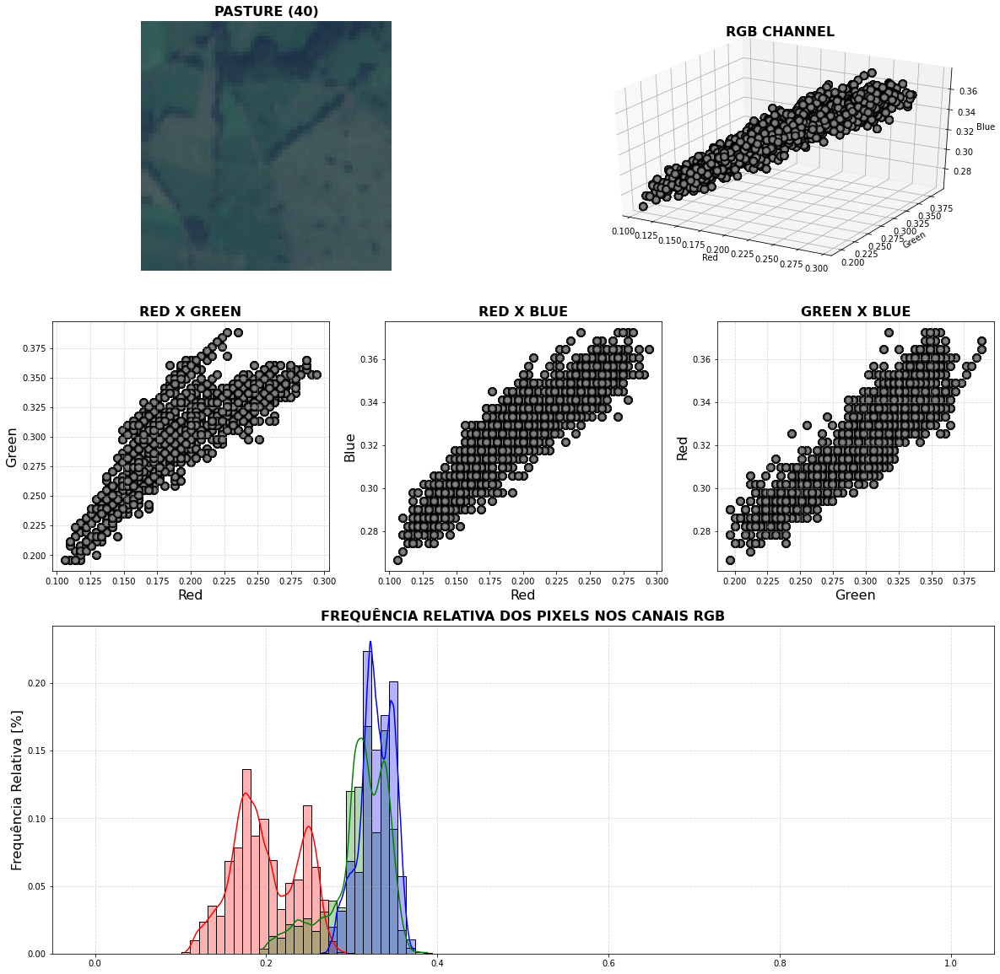

In [12]:
r = img[0][idx][:, :, 0].ravel()
g = img[0][idx][:, :, 1].ravel()
b = img[0][idx][:, :, 2].ravel()
bins = np.linspace(0, 1, 100)


fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot(2, 2, 1)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"{class_name} ({idx})".upper(), fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(sample_image)
ax.axis('off')

ax = fig.add_subplot(2, 2, 2, projection='3d')
ax.grid(ls='--', alpha=0.5)
ax.set_title("RGB CHANNEL", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter3D(r, g, b, s=70, lw=2, ec='k', color='grey', alpha=0.5)
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')


ax = fig.add_subplot(2, 3, 4)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Green", fontsize=16)
ax.set_title("RED X GREEN", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, g, s=70, lw=2, ec='k', color='grey', alpha=0.5)

ax = fig.add_subplot(2, 3, 5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Blue", fontsize=16)
ax.set_title("RED X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, b, s=70, lw=2, ec='k', color='grey', alpha=0.5)


ax = fig.add_subplot(2, 3, 6)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Green", fontsize=16)
ax.set_ylabel("Red", fontsize=16)
ax.set_title("GREEN X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(g, b, s=70, lw=2, ec='k', color='grey', alpha=0.5)


# ax = fig.add_axes([0.15, -0.3, 0.75, 0.4])
ax = fig.add_axes([0.125, -0.4, 0.775, 0.45])
ax.set_title("FREQUÊNCIA RELATIVA DOS PIXELS NOS CANAIS RGB", 
             fontdict={'size': 16, 'weight': 'bold'})
ax.set_ylabel("Frequência Relativa [%]", fontsize=16)
sns.histplot(
    r, label='Red', log_scale=False, stat="probability", 
    color='red', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.3, ax=ax
)
sns.histplot(
    g, label='Green', log_scale=False, stat="probability", 
    color='green', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.3, ax=ax
)
sns.histplot(
    b, label='Blue', log_scale=False, stat="probability", 
    color='blue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.3, ax=ax
)
ax.grid(ls='--', alpha=0.5)

plt.savefig(
    f"{results_path}/space_attributes.png", transparent=False, bbox_inches='tight', 
    pad_inches=0.1
)
plt.savefig(
    f"{results_path}/space_attributes.pdf", transparent=False, bbox_inches='tight', 
    pad_inches=0.1
)

## 3. Data augmentation techniques

### 3.1. Rotation
<hr />

A preprocessing layer which randomly rotates images during training.
Informations of method avaiable at: [https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomRotation](https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomRotation).

In [14]:
print(help(tf.keras.layers.experimental.preprocessing.RandomRotation))

Help on class RandomRotation in module keras.layers.preprocessing.image_preprocessing:

class RandomRotation(keras.engine.base_layer.Layer)
 |  RandomRotation(*args, **kwargs)
 |  
 |  Randomly rotate each image.
 |  
 |  By default, random rotations are only applied during training.
 |  At inference time, the layer does nothing. If you need to apply random
 |  rotations at inference time, set `training` to True when calling the layer.
 |  
 |  Input shape:
 |    3D (unbatched) or 4D (batched) tensor with shape:
 |    `(..., height, width, channels)`, in `"channels_last"` format
 |  
 |  Output shape:
 |    3D (unbatched) or 4D (batched) tensor with shape:
 |    `(..., height, width, channels)`, in `"channels_last"` format
 |  
 |  Attributes:
 |    factor: a float represented as fraction of 2 Pi, or a tuple of size 2
 |      representing lower and upper bound for rotating clockwise and
 |      counter-clockwise. A positive values means rotating counter clock-wise,
 |      while a nega

Plotting some examples using random rotation.

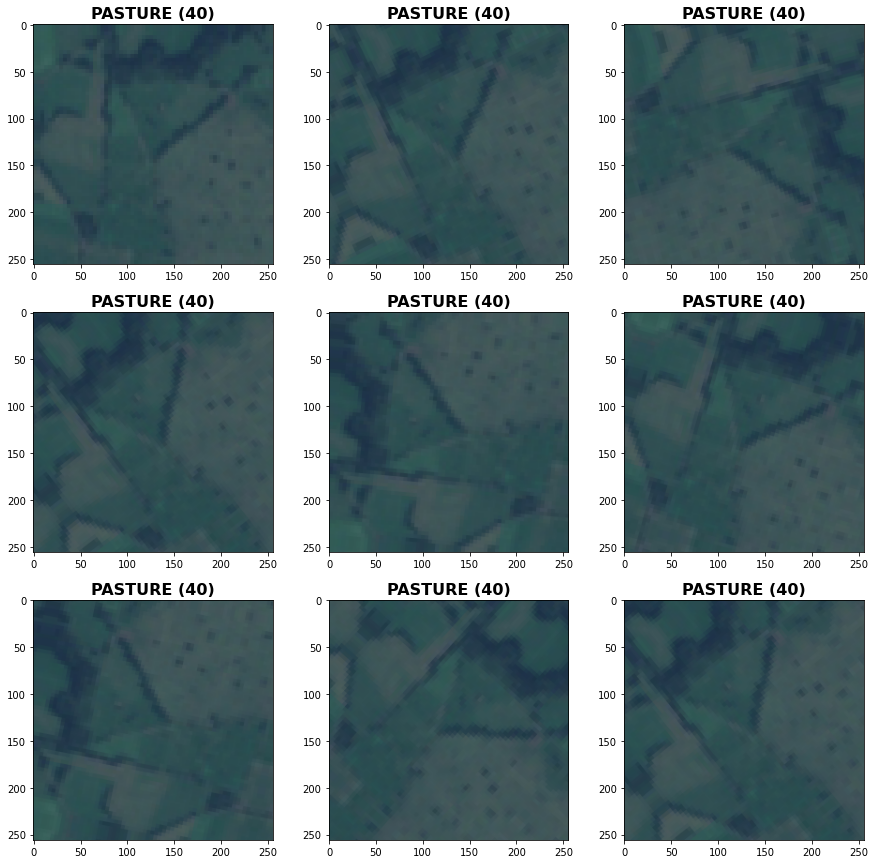

In [15]:
set_seed()
random_rotation_DA = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.RandomRotation(
        factor=0.25, 
        fill_mode='reflect', 
        interpolation='bilinear',
        fill_value=0.0
    )
])

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3*3):
    row = i//3
    col = i%3
    ax[row][col].set_title(f"{class_name} ({idx})".upper(), fontdict={'size': 16, 'weight': 'bold'})
    if row + col == 0:
        ax[row][col].imshow(sample_image)
    else:
        image_da = random_rotation_DA(
            tf.expand_dims(sample_image, axis=0)
        )[0, :, :, :]
        ax[row][col].imshow(image_da)
    
plt.savefig(
    f"{results_path}/da_rotation.png", transparent=False, bbox_inches='tight', 
    pad_inches=0.1
)
plt.savefig(
    f"{results_path}/da_rotation.pdf", transparent=False, bbox_inches='tight', 
    pad_inches=0.1
)

Comparing attribute space of original image and random rotated image.

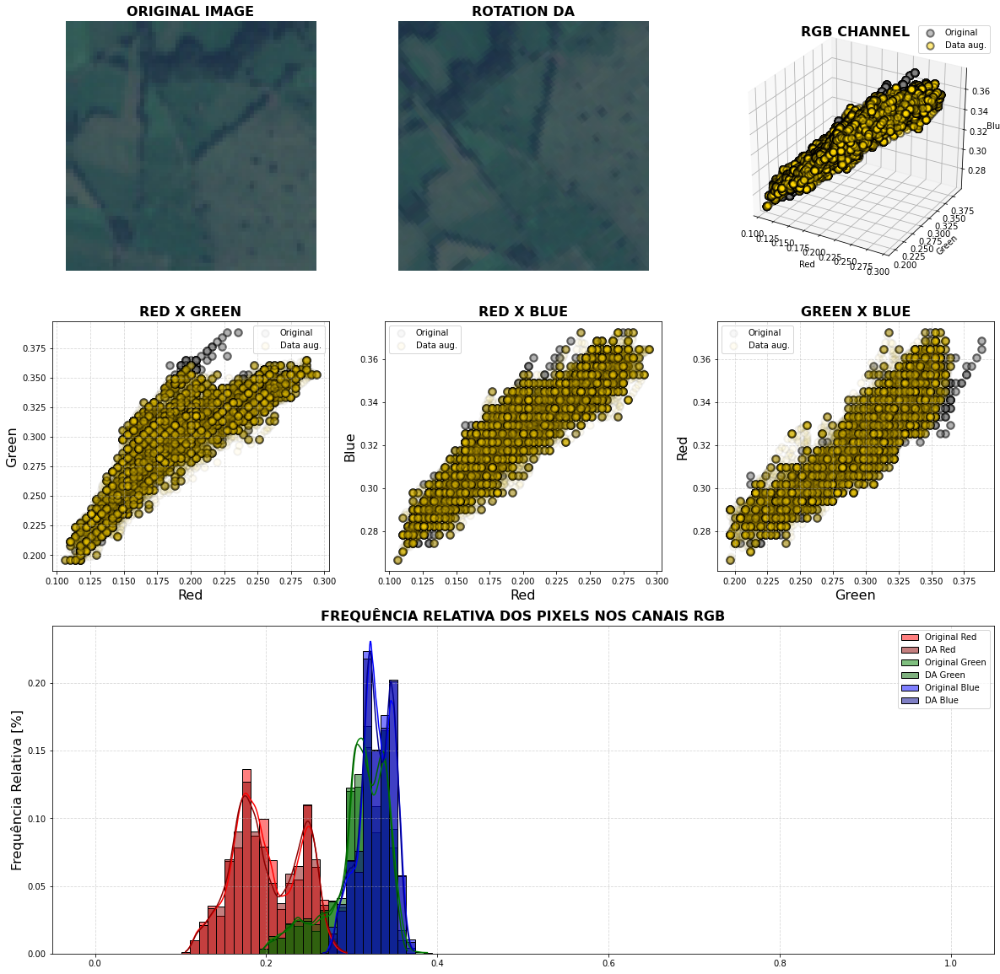

In [16]:
r_da = image_da[:, :, 0].numpy().ravel()
g_da = image_da[:, :, 1].numpy().ravel()
b_da = image_da[:, :, 2].numpy().ravel()

fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot(2, 3, 1)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"ORIGINAL IMAGE", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(sample_image)
ax.axis('off')

ax = fig.add_subplot(2, 3, 2)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"ROTATION DA", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(image_da)
ax.axis('off')

ax = fig.add_subplot(2, 3, 3, projection='3d')
ax.grid(ls='--', alpha=0.5)
ax.set_title("RGB CHANNEL", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter3D(r, g, b, s=70, lw=2, ec='k', color='grey', alpha=0.5, label='Original')
ax.scatter3D(r_da, g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.5, label='Data aug.')
ax.legend()
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')


ax = fig.add_subplot(2, 3, 4)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Green", fontsize=16)
ax.set_title("RED X GREEN", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, g, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, g_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Blue", fontsize=16)
ax.set_title("RED X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 6)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Green", fontsize=16)
ax.set_ylabel("Red", fontsize=16)
ax.set_title("GREEN X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(g, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

# ax = fig.add_axes([0.15, -0.3, 0.75, 0.4])
ax = fig.add_axes([0.125, -0.4, 0.775, 0.45])
ax.set_title("FREQUÊNCIA RELATIVA DOS PIXELS NOS CANAIS RGB", 
             fontdict={'size': 16, 'weight': 'bold'})
ax.set_ylabel("Frequência Relativa [%]", fontsize=16)
sns.histplot(
    r, label='Original Red', log_scale=False, stat="probability", 
    color='red', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    r_da, label='DA Red', log_scale=False, stat="probability", 
    color='darkred', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    g, label='Original Green', log_scale=False, stat="probability", 
    color='green', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    g_da, label='DA Green', log_scale=False, stat="probability", 
    color='darkgreen', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    b, label='Original Blue', log_scale=False, stat="probability", 
    color='blue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    b_da, label='DA Blue', log_scale=False, stat="probability", 
    color='darkblue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

ax.grid(ls='--', alpha=0.5)
ax.legend()

plt.savefig(
    f"{results_path}/space_attrs_da_rotation.png", transparent=False, bbox_inches='tight', 
    pad_inches=0.1
)
plt.savefig(
    f"{results_path}/space_attrs_da_rotation.pdf", transparent=False, bbox_inches='tight', 
    pad_inches=0.1
)

### 3.2. Flip
<hr />

A preprocessing layer which randomly flips images during training.
Informations of method avaiable at: [https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomFlip](https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomFlip).

In [17]:
print(help(tf.keras.layers.experimental.preprocessing.RandomFlip))

Help on class RandomFlip in module keras.layers.preprocessing.image_preprocessing:

class RandomFlip(keras.engine.base_layer.Layer)
 |  RandomFlip(*args, **kwargs)
 |  
 |  Randomly flip each image horizontally and vertically.
 |  
 |  This layer will flip the images based on the `mode` attribute.
 |  During inference time, the output will be identical to input. Call the layer
 |  with `training=True` to flip the input.
 |  
 |  Input shape:
 |    3D (unbatched) or 4D (batched) tensor with shape:
 |    `(..., height, width, channels)`, in `"channels_last"` format.
 |  
 |  Output shape:
 |    3D (unbatched) or 4D (batched) tensor with shape:
 |    `(..., height, width, channels)`, in `"channels_last"` format.
 |  
 |  Attributes:
 |    mode: String indicating which flip mode to use. Can be `"horizontal"`,
 |      `"vertical"`, or `"horizontal_and_vertical"`. Defaults to
 |      `"horizontal_and_vertical"`. `"horizontal"` is a left-right flip and
 |      `"vertical"` is a top-bottom fli

Plotting some examples using random flip.

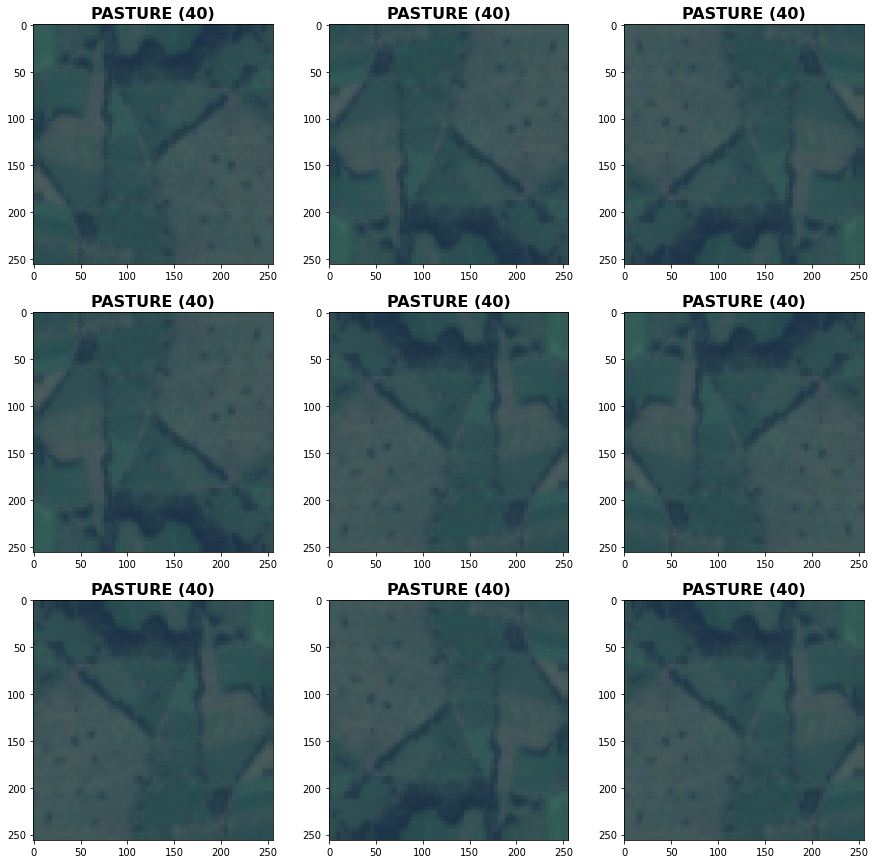

In [18]:
set_seed()
random_flip_DA = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.RandomFlip(
        mode='horizontal_and_vertical'
    )
])

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3*3):
    row = i//3
    col = i%3
    ax[row][col].set_title(f"{class_name} ({idx})".upper(), fontdict={'size': 16, 'weight': 'bold'})
    if row + col == 0:
        ax[row][col].imshow(sample_image)
    else:
        image_da = random_flip_DA(
            tf.expand_dims(sample_image, axis=0)
        )[0, :, :, :]
        ax[row][col].imshow(image_da)
    

Comparing attribute space of original image and random flip image.

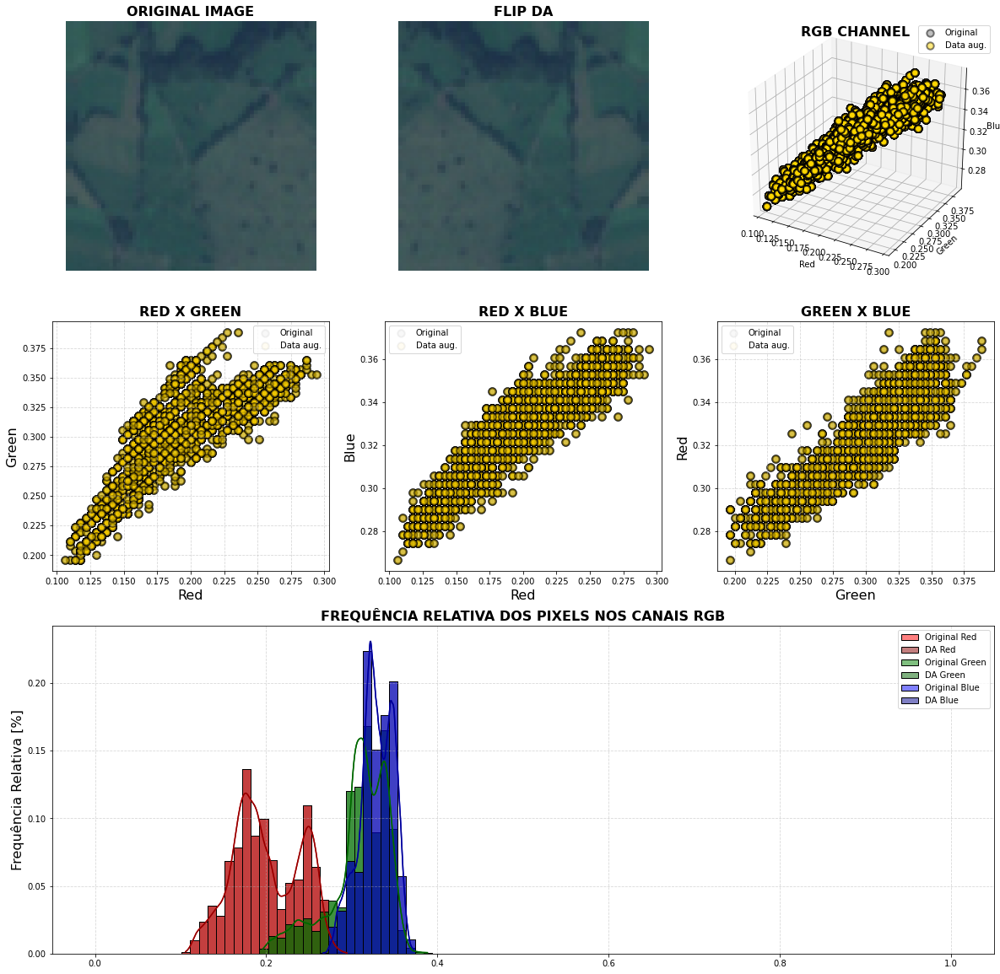

In [19]:
r_da = image_da[:, :, 0].numpy().ravel()
g_da = image_da[:, :, 1].numpy().ravel()
b_da = image_da[:, :, 2].numpy().ravel()

fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot(2, 3, 1)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"ORIGINAL IMAGE", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(sample_image)
ax.axis('off')

ax = fig.add_subplot(2, 3, 2)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"FLIP DA", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(image_da)
ax.axis('off')

ax = fig.add_subplot(2, 3, 3, projection='3d')
ax.grid(ls='--', alpha=0.5)
ax.set_title("RGB CHANNEL", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter3D(r, g, b, s=70, lw=2, ec='k', color='grey', alpha=0.5, label='Original')
ax.scatter3D(r_da, g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.5, label='Data aug.')
ax.legend()
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')


ax = fig.add_subplot(2, 3, 4)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Green", fontsize=16)
ax.set_title("RED X GREEN", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, g, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, g_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Blue", fontsize=16)
ax.set_title("RED X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 6)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Green", fontsize=16)
ax.set_ylabel("Red", fontsize=16)
ax.set_title("GREEN X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(g, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

# ax = fig.add_axes([0.15, -0.3, 0.75, 0.4])
ax = fig.add_axes([0.125, -0.4, 0.775, 0.45])
ax.set_title("FREQUÊNCIA RELATIVA DOS PIXELS NOS CANAIS RGB", 
             fontdict={'size': 16, 'weight': 'bold'})
ax.set_ylabel("Frequência Relativa [%]", fontsize=16)
sns.histplot(
    r, label='Original Red', log_scale=False, stat="probability", 
    color='red', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    r_da, label='DA Red', log_scale=False, stat="probability", 
    color='darkred', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    g, label='Original Green', log_scale=False, stat="probability", 
    color='green', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    g_da, label='DA Green', log_scale=False, stat="probability", 
    color='darkgreen', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    b, label='Original Blue', log_scale=False, stat="probability", 
    color='blue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    b_da, label='DA Blue', log_scale=False, stat="probability", 
    color='darkblue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

ax.grid(ls='--', alpha=0.5)
ax.legend()



### 3.3. Zoom
<hr />

A preprocessing layer which randomly zooms images during training.
Informations of method avaiable at: [https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomZoom](https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomZoom).


In [20]:
help(tf.keras.layers.experimental.preprocessing.RandomZoom)

Help on class RandomZoom in module keras.layers.preprocessing.image_preprocessing:

class RandomZoom(keras.engine.base_layer.Layer)
 |  RandomZoom(*args, **kwargs)
 |  
 |  Randomly zoom each image during training.
 |  
 |  Args:
 |    height_factor: a float represented as fraction of value, or a tuple of size
 |      2 representing lower and upper bound for zooming vertically. When
 |      represented as a single float, this value is used for both the upper and
 |      lower bound. A positive value means zooming out, while a negative value
 |      means zooming in. For instance, `height_factor=(0.2, 0.3)` result in an
 |      output zoomed out by a random amount in the range `[+20%, +30%]`.
 |      `height_factor=(-0.3, -0.2)` result in an output zoomed in by a random
 |      amount in the range `[+20%, +30%]`.
 |    width_factor: a float represented as fraction of value, or a tuple of size 2
 |      representing lower and upper bound for zooming horizontally. When
 |      represented

Plotting some examples using random zoom.

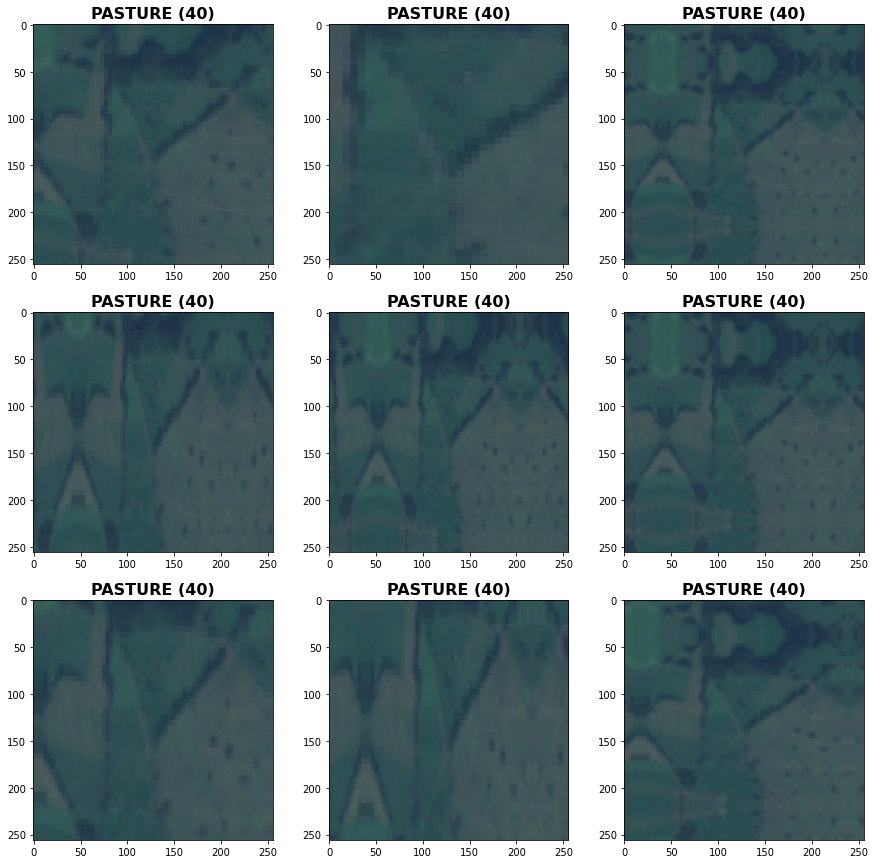

In [21]:
set_seed()
random_zoom_DA = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.RandomZoom(
        height_factor=0.5, 
        width_factor=0.75, 
        fill_mode='reflect',
        interpolation='bilinear'
        
    )
])

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3*3):
    row = i//3
    col = i%3
    ax[row][col].set_title(f"{class_name} ({idx})".upper(), fontdict={'size': 16, 'weight': 'bold'})
    if row + col == 0:
        ax[row][col].imshow(sample_image)
    else:
        image_da = random_zoom_DA(
            tf.expand_dims(sample_image, axis=0)
        )[0, :, :, :]
        ax[row][col].imshow(image_da)
    

Comparing attribute space of original image and using random zoom.

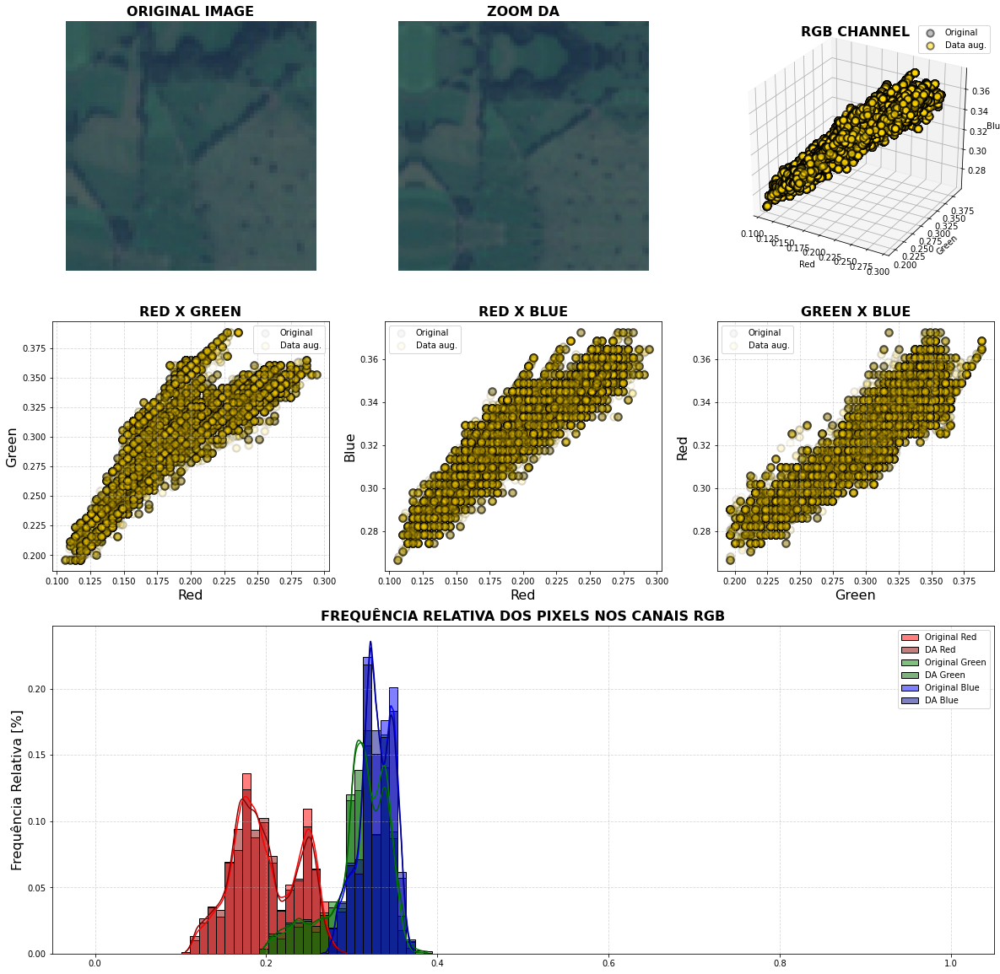

In [22]:
r_da = image_da[:, :, 0].numpy().ravel()
g_da = image_da[:, :, 1].numpy().ravel()
b_da = image_da[:, :, 2].numpy().ravel()

fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot(2, 3, 1)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"ORIGINAL IMAGE", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(sample_image)
ax.axis('off')

ax = fig.add_subplot(2, 3, 2)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"ZOOM DA", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(image_da)
ax.axis('off')

ax = fig.add_subplot(2, 3, 3, projection='3d')
ax.grid(ls='--', alpha=0.5)
ax.set_title("RGB CHANNEL", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter3D(r, g, b, s=70, lw=2, ec='k', color='grey', alpha=0.5, label='Original')
ax.scatter3D(r_da, g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.5, label='Data aug.')
ax.legend()
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')


ax = fig.add_subplot(2, 3, 4)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Green", fontsize=16)
ax.set_title("RED X GREEN", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, g, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, g_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Blue", fontsize=16)
ax.set_title("RED X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 6)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Green", fontsize=16)
ax.set_ylabel("Red", fontsize=16)
ax.set_title("GREEN X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(g, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_axes([0.125, -0.4, 0.775, 0.45])
ax.set_title("FREQUÊNCIA RELATIVA DOS PIXELS NOS CANAIS RGB", 
             fontdict={'size': 16, 'weight': 'bold'})
ax.set_ylabel("Frequência Relativa [%]", fontsize=16)
sns.histplot(
    r, label='Original Red', log_scale=False, stat="probability", 
    color='red', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    r_da, label='DA Red', log_scale=False, stat="probability", 
    color='darkred', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    g, label='Original Green', log_scale=False, stat="probability", 
    color='green', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    g_da, label='DA Green', log_scale=False, stat="probability", 
    color='darkgreen', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    b, label='Original Blue', log_scale=False, stat="probability", 
    color='blue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    b_da, label='DA Blue', log_scale=False, stat="probability", 
    color='darkblue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

ax.grid(ls='--', alpha=0.5)
ax.legend()

### 3.4. Contrast
<hr />

A preprocessing layer which randomly adjusts contrast during training.
Informations of method avaiable at: [https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomContrast](https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomContrast).

In [23]:
print(help(tf.keras.layers.experimental.preprocessing.RandomContrast))

Help on class RandomContrast in module keras.layers.preprocessing.image_preprocessing:

class RandomContrast(keras.engine.base_layer.Layer)
 |  RandomContrast(*args, **kwargs)
 |  
 |  Adjust the contrast of an image or images by a random factor.
 |  
 |  Contrast is adjusted independently for each channel of each image during
 |  training.
 |  
 |  For each channel, this layer computes the mean of the image pixels in the
 |  channel and then adjusts each component `x` of each pixel to
 |  `(x - mean) * contrast_factor + mean`.
 |  
 |  Input shape:
 |    3D (unbatched) or 4D (batched) tensor with shape:
 |    `(..., height, width, channels)`, in `"channels_last"` format.
 |  
 |  Output shape:
 |    3D (unbatched) or 4D (batched) tensor with shape:
 |    `(..., height, width, channels)`, in `"channels_last"` format.
 |  
 |  Attributes:
 |    factor: a positive float represented as fraction of value, or a tuple of
 |      size 2 representing lower and upper bound. When represented as 

Plotting some examples using random contrast.

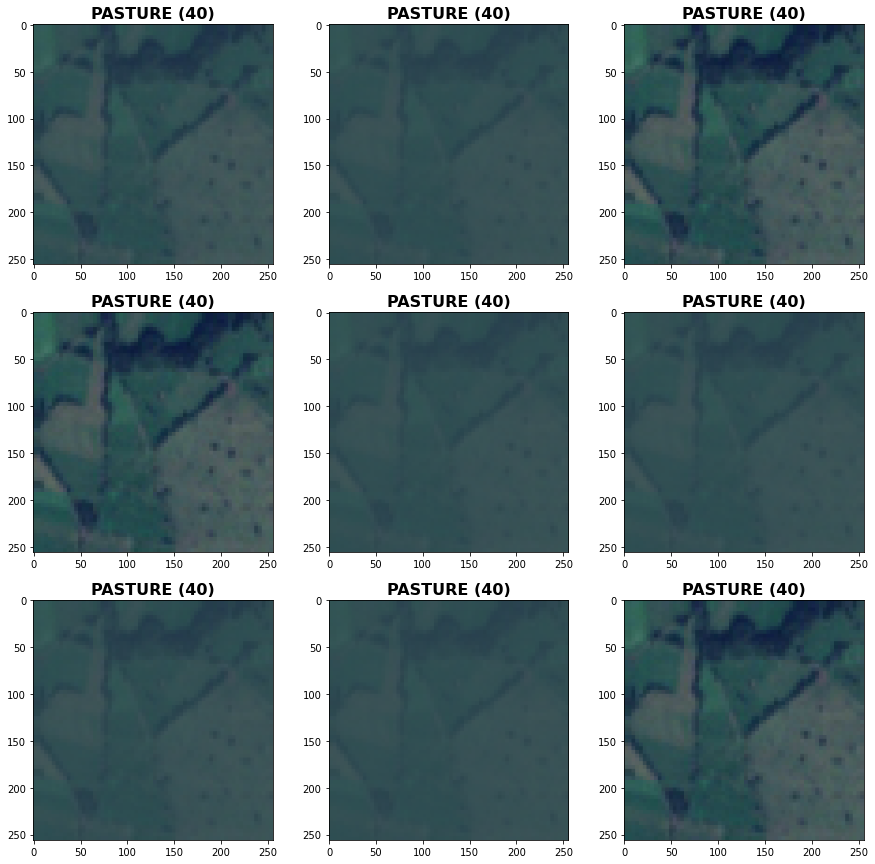

In [24]:
set_seed()
random_contrast_DA = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.RandomContrast(
        factor=0.8
    )
])

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3*3):
    row = i//3
    col = i%3
    ax[row][col].set_title(f"{class_name} ({idx})".upper(), fontdict={'size': 16, 'weight': 'bold'})
    if row + col == 0:
        ax[row][col].imshow(sample_image)
    else:
        image_da = random_contrast_DA(
            tf.expand_dims(sample_image, axis=0)
        )[0, :, :, :]
        ax[row][col].imshow(image_da)
    

Comparing attribute space of original image and random contrast image.

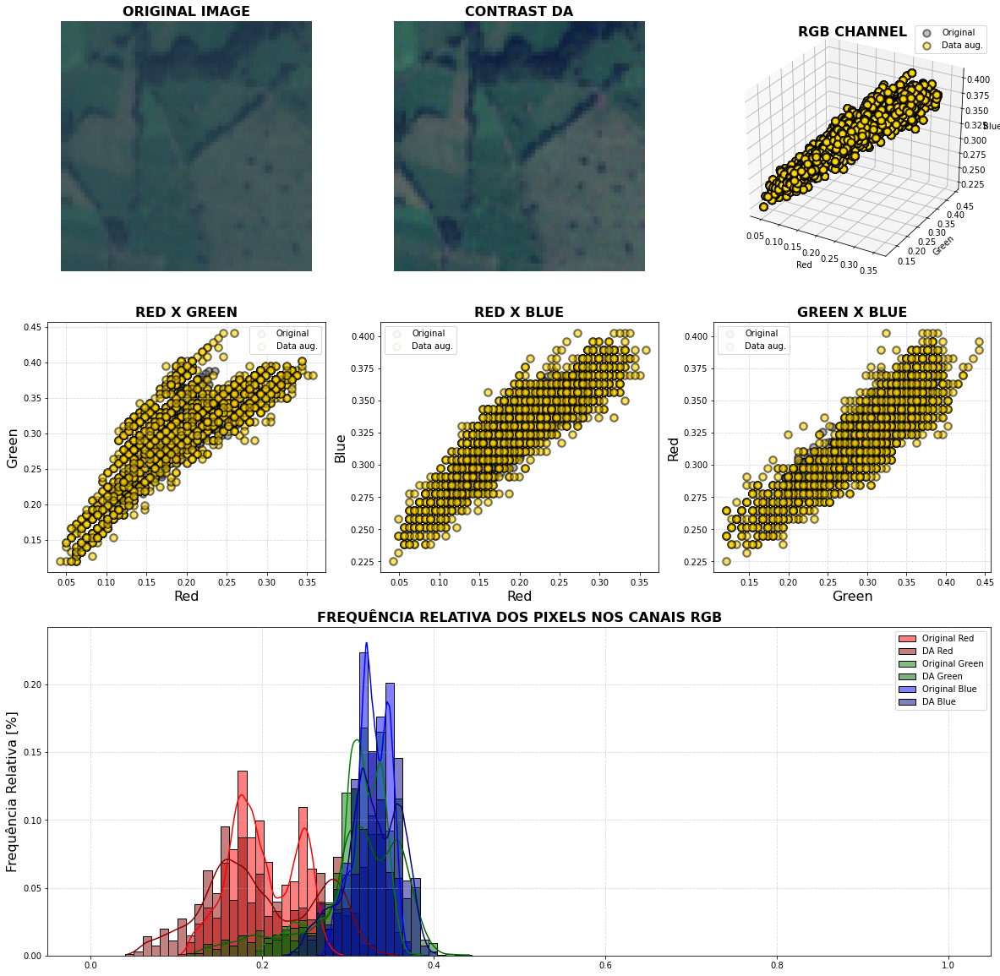

In [25]:
r_da = image_da[:, :, 0].numpy().ravel()
g_da = image_da[:, :, 1].numpy().ravel()
b_da = image_da[:, :, 2].numpy().ravel()

fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot(2, 3, 1)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"ORIGINAL IMAGE", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(sample_image)
ax.axis('off')

ax = fig.add_subplot(2, 3, 2)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"CONTRAST DA", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(image_da)
ax.axis('off')

ax = fig.add_subplot(2, 3, 3, projection='3d')
ax.grid(ls='--', alpha=0.5)
ax.set_title("RGB CHANNEL", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter3D(r, g, b, s=70, lw=2, ec='k', color='grey', alpha=0.5, label='Original')
ax.scatter3D(r_da, g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.5, label='Data aug.')
ax.legend()
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')


ax = fig.add_subplot(2, 3, 4)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Green", fontsize=16)
ax.set_title("RED X GREEN", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, g, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, g_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Blue", fontsize=16)
ax.set_title("RED X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 6)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Green", fontsize=16)
ax.set_ylabel("Red", fontsize=16)
ax.set_title("GREEN X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(g, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_axes([0.125, -0.4, 0.775, 0.45])
ax.set_title("FREQUÊNCIA RELATIVA DOS PIXELS NOS CANAIS RGB", 
             fontdict={'size': 16, 'weight': 'bold'})
ax.set_ylabel("Frequência Relativa [%]", fontsize=16)
sns.histplot(
    r, label='Original Red', log_scale=False, stat="probability", 
    color='red', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    r_da, label='DA Red', log_scale=False, stat="probability", 
    color='darkred', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    g, label='Original Green', log_scale=False, stat="probability", 
    color='green', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    g_da, label='DA Green', log_scale=False, stat="probability", 
    color='darkgreen', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    b, label='Original Blue', log_scale=False, stat="probability", 
    color='blue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    b_da, label='DA Blue', log_scale=False, stat="probability", 
    color='darkblue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

ax.grid(ls='--', alpha=0.5)
ax.legend()

### 3.5. Brihtness
<hr />

Adjust the brightness of images by a random factor.
Informations of method avaiable at: [https://www.tensorflow.org/api_docs/python/tf/image/random_brightness](https://www.tensorflow.org/api_docs/python/tf/image/random_brightness).

In [26]:
print(help(tf.image.random_brightness))

Help on function random_brightness in module tensorflow.python.ops.image_ops_impl:

random_brightness(image, max_delta, seed=None)
    Adjust the brightness of images by a random factor.
    
    Equivalent to `adjust_brightness()` using a `delta` randomly picked in the
    interval `[-max_delta, max_delta)`.
    
    For producing deterministic results given a `seed` value, use
    `tf.image.stateless_random_brightness`. Unlike using the `seed` param
    with `tf.image.random_*` ops, `tf.image.stateless_random_*` ops guarantee the
    same results given the same seed independent of how many times the function is
    called, and independent of global seed settings (e.g. tf.random.set_seed).
    
    Args:
      image: An image or images to adjust.
      max_delta: float, must be non-negative.
      seed: A Python integer. Used to create a random seed. See
        `tf.compat.v1.set_random_seed` for behavior.
    
    Usage Example:
    
    >>> x = [[[1.0, 2.0, 3.0],
    ...       [4.0,

Plotting some examples using an brightness factor.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


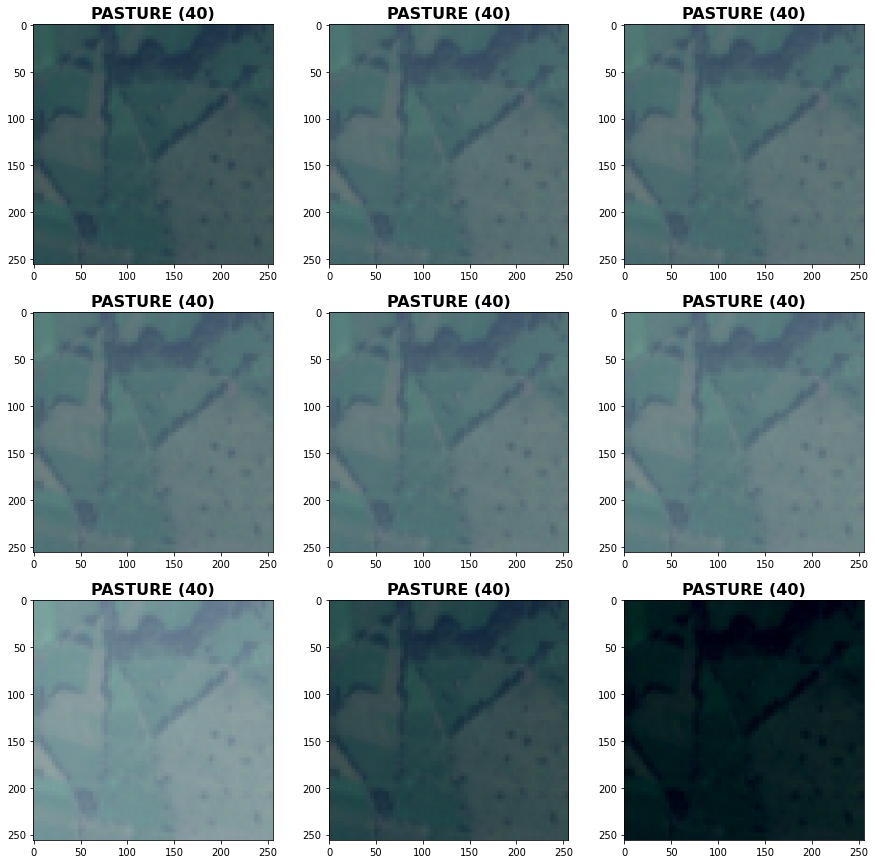

In [27]:
set_seed()
random_brightness_DA = lambda image: tf.image.random_brightness(image, max_delta=0.3)

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3*3):
    row = i//3
    col = i%3
    ax[row][col].set_title(f"{class_name} ({idx})".upper(), fontdict={'size': 16, 'weight': 'bold'})
    if row + col == 0:
        ax[row][col].imshow(sample_image)
    else:
        image_da = random_brightness_DA(
            tf.expand_dims(sample_image, axis=0)
        )[0, :, :, :]
        ax[row][col].imshow(image_da)
    

Comparing attribute space of original image and contrasted image.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


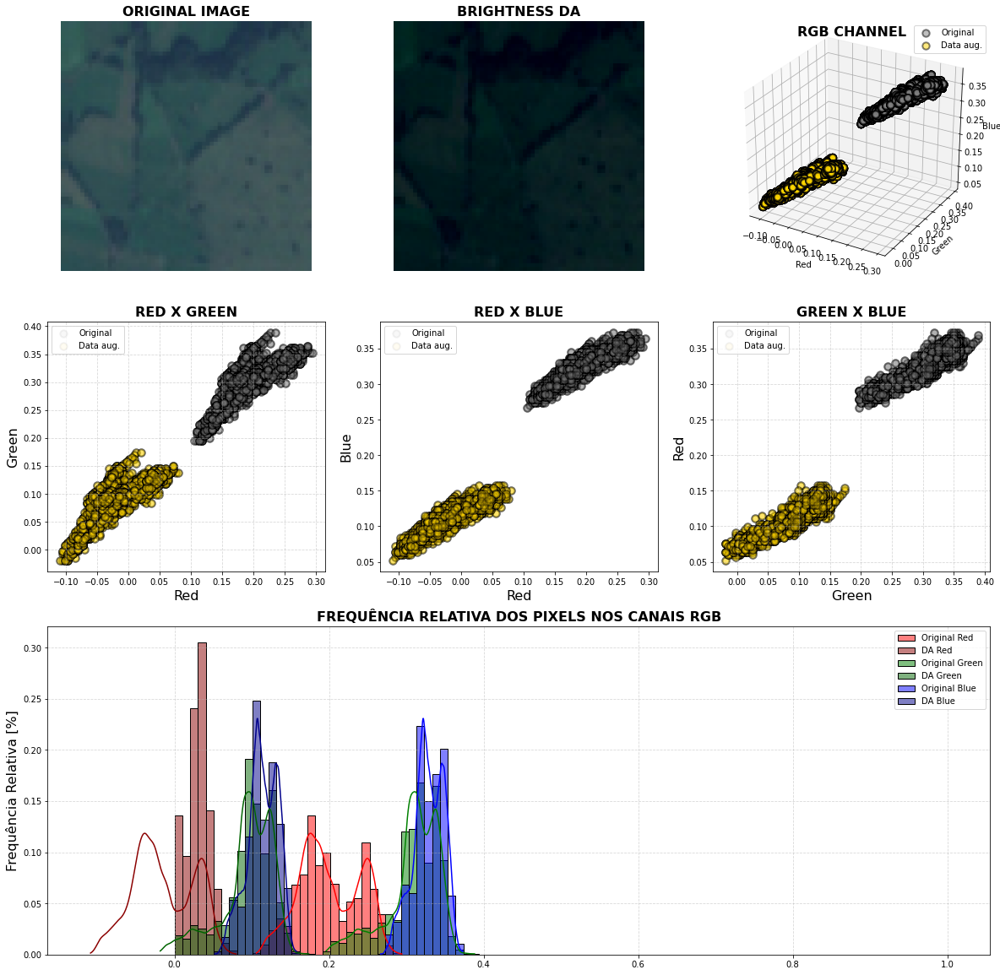

In [28]:
r_da = image_da[:, :, 0].numpy().ravel()
g_da = image_da[:, :, 1].numpy().ravel()
b_da = image_da[:, :, 2].numpy().ravel()

fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot(2, 3, 1)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"ORIGINAL IMAGE", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(sample_image)
ax.axis('off')

ax = fig.add_subplot(2, 3, 2)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"BRIGHTNESS DA", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(image_da)
ax.axis('off')

ax = fig.add_subplot(2, 3, 3, projection='3d')
ax.grid(ls='--', alpha=0.5)
ax.set_title("RGB CHANNEL", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter3D(r, g, b, s=70, lw=2, ec='k', color='grey', alpha=0.5, label='Original')
ax.scatter3D(r_da, g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.5, label='Data aug.')
ax.legend()
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')


ax = fig.add_subplot(2, 3, 4)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Green", fontsize=16)
ax.set_title("RED X GREEN", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, g, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, g_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Blue", fontsize=16)
ax.set_title("RED X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 6)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Green", fontsize=16)
ax.set_ylabel("Red", fontsize=16)
ax.set_title("GREEN X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(g, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_axes([0.125, -0.4, 0.775, 0.45])
ax.set_title("FREQUÊNCIA RELATIVA DOS PIXELS NOS CANAIS RGB", 
             fontdict={'size': 16, 'weight': 'bold'})
ax.set_ylabel("Frequência Relativa [%]", fontsize=16)
sns.histplot(
    r, label='Original Red', log_scale=False, stat="probability", 
    color='red', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    r_da, label='DA Red', log_scale=False, stat="probability", 
    color='darkred', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    g, label='Original Green', log_scale=False, stat="probability", 
    color='green', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    g_da, label='DA Green', log_scale=False, stat="probability", 
    color='darkgreen', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    b, label='Original Blue', log_scale=False, stat="probability", 
    color='blue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    b_da, label='DA Blue', log_scale=False, stat="probability", 
    color='darkblue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

ax.grid(ls='--', alpha=0.5)
ax.legend()

### 3.6. HUE
<hr />

Adjust the hue of RGB images by a random factor.
Informations of method avaiable at: [https://www.tensorflow.org/api_docs/python/tf/image/random_hue](https://www.tensorflow.org/api_docs/python/tf/image/random_hue).

In [29]:
print(help(tf.image.random_hue))

Help on function random_hue in module tensorflow.python.ops.image_ops_impl:

random_hue(image, max_delta, seed=None)
    Adjust the hue of RGB images by a random factor.
    
    Equivalent to `adjust_hue()` but uses a `delta` randomly
    picked in the interval `[-max_delta, max_delta)`.
    
    `max_delta` must be in the interval `[0, 0.5]`.
    
    Usage Example:
    
    >>> x = [[[1.0, 2.0, 3.0],
    ...       [4.0, 5.0, 6.0]],
    ...     [[7.0, 8.0, 9.0],
    ...       [10.0, 11.0, 12.0]]]
    >>> tf.image.random_hue(x, 0.2)
    <tf.Tensor: shape=(2, 2, 3), dtype=float32, numpy=...>
    
    For producing deterministic results given a `seed` value, use
    `tf.image.stateless_random_hue`. Unlike using the `seed` param with
    `tf.image.random_*` ops, `tf.image.stateless_random_*` ops guarantee the same
    results given the same seed independent of how many times the function is
    called, and independent of global seed settings (e.g. tf.random.set_seed).
    
    Args:
    

Plotting some examples applying HUE.

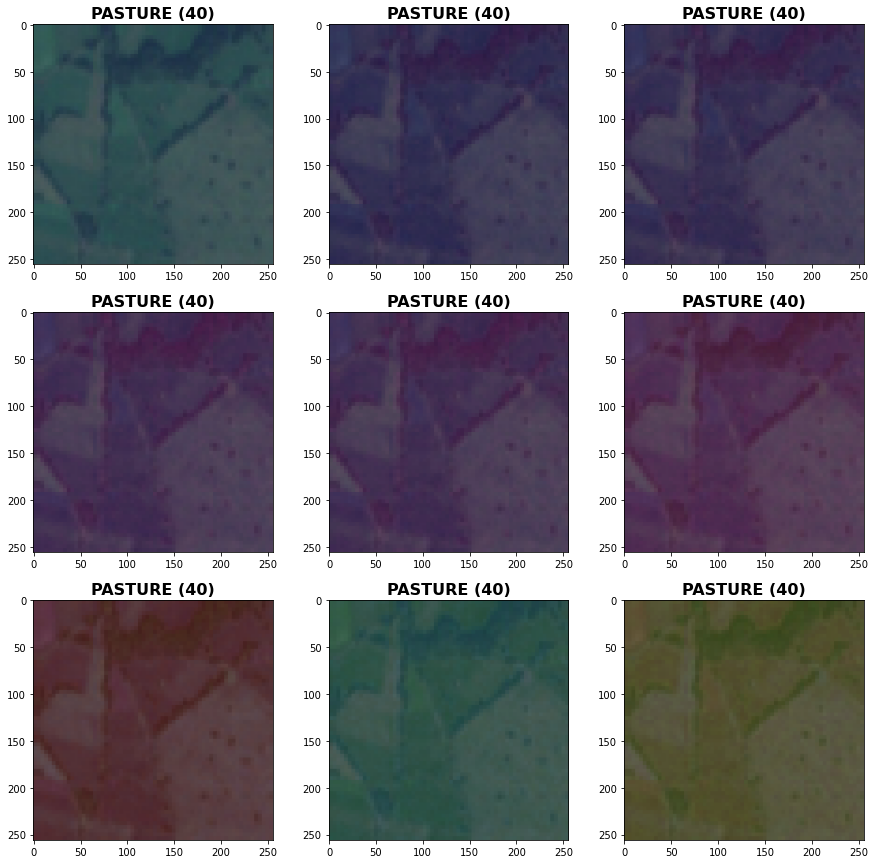

In [30]:
set_seed()
random_hue_DA = lambda image: tf.image.random_hue(image, max_delta=0.5)

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3*3):
    row = i//3
    col = i%3
    ax[row][col].set_title(f"{class_name} ({idx})".upper(), fontdict={'size': 16, 'weight': 'bold'})
    if row + col == 0:
        ax[row][col].imshow(sample_image)
    else:
        image_da = random_hue_DA(
            tf.expand_dims(sample_image, axis=0)
        )[0, :, :, :]
        ax[row][col].imshow(image_da)
    

Comparing attribute space of original image and image with HUE manipulation.

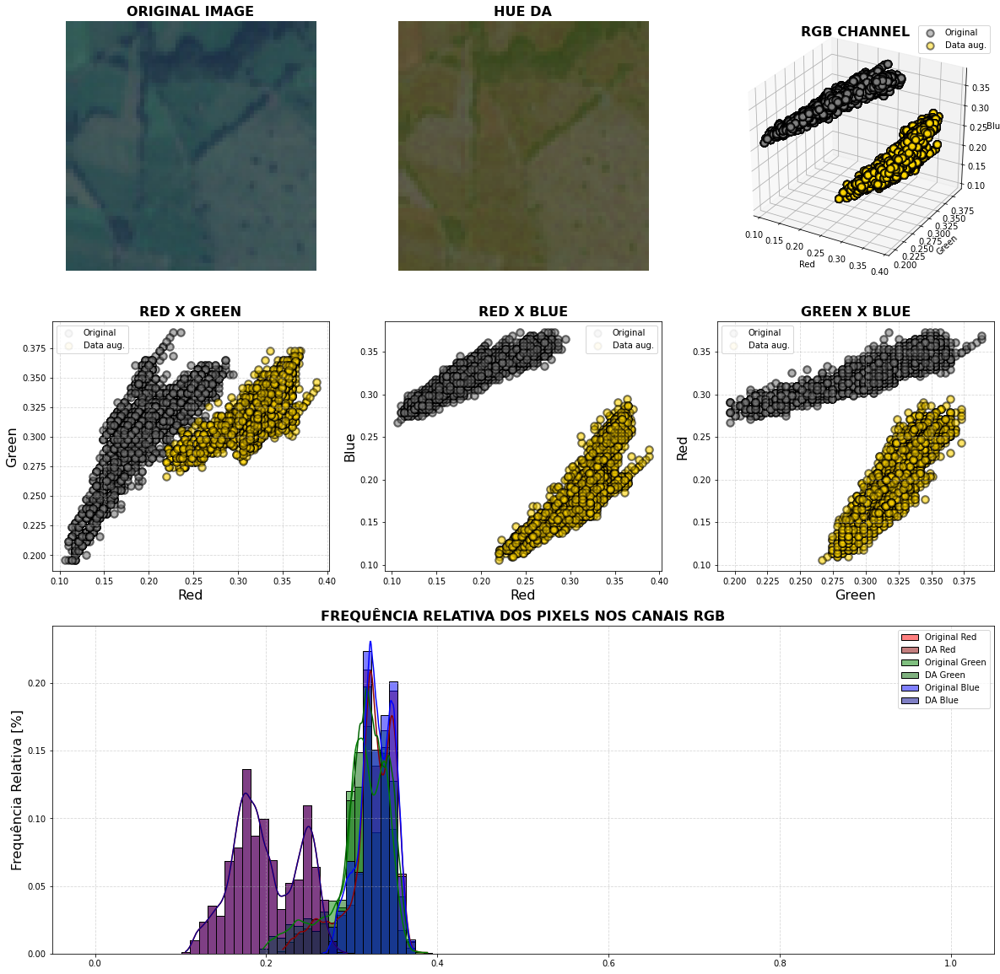

In [31]:
r_da = image_da[:, :, 0].numpy().ravel()
g_da = image_da[:, :, 1].numpy().ravel()
b_da = image_da[:, :, 2].numpy().ravel()

fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot(2, 3, 1)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"ORIGINAL IMAGE", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(sample_image)
ax.axis('off')

ax = fig.add_subplot(2, 3, 2)
ax.grid(ls='--', alpha=0.5)

ax.set_title(f"HUE DA", fontdict={'size': 16, 'weight': 'bold'})
ax.imshow(image_da)
ax.axis('off')

ax = fig.add_subplot(2, 3, 3, projection='3d')
ax.grid(ls='--', alpha=0.5)
ax.set_title("RGB CHANNEL", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter3D(r, g, b, s=70, lw=2, ec='k', color='grey', alpha=0.5, label='Original')
ax.scatter3D(r_da, g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.5, label='Data aug.')
ax.legend()
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')


ax = fig.add_subplot(2, 3, 4)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Green", fontsize=16)
ax.set_title("RED X GREEN", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, g, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, g_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 5)
ax.set_xlabel("Red", fontsize=16)
ax.set_ylabel("Blue", fontsize=16)
ax.set_title("RED X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(r, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(r_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_subplot(2, 3, 6)
ax.grid(ls='--', alpha=0.5)
ax.set_xlabel("Green", fontsize=16)
ax.set_ylabel("Red", fontsize=16)
ax.set_title("GREEN X BLUE", fontdict={'size': 16, 'weight': 'bold'})
ax.scatter(g, b, s=70, lw=2, ec='k', color='grey', alpha=0.05, label='Original')
ax.scatter(g_da, b_da, s=70, lw=2, ec='k', color='gold', alpha=0.05, label='Data aug.')
ax.legend()

ax = fig.add_axes([0.125, -0.4, 0.775, 0.45])
ax.set_title("FREQUÊNCIA RELATIVA DOS PIXELS NOS CANAIS RGB", 
             fontdict={'size': 16, 'weight': 'bold'})
ax.set_ylabel("Frequência Relativa [%]", fontsize=16)
sns.histplot(
    r, label='Original Red', log_scale=False, stat="probability", 
    color='red', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    r_da, label='DA Red', log_scale=False, stat="probability", 
    color='darkred', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    g, label='Original Green', log_scale=False, stat="probability", 
    color='green', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    g_da, label='DA Green', log_scale=False, stat="probability", 
    color='darkgreen', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

sns.histplot(
    b, label='Original Blue', log_scale=False, stat="probability", 
    color='blue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)
sns.histplot(
    b_da, label='DA Blue', log_scale=False, stat="probability", 
    color='darkblue', bins=bins, kde=True, edgecolor="k", 
    linewidth=1, alpha=0.5, ax=ax
)

ax.grid(ls='--', alpha=0.5)
ax.legend()

## 4. Exercise 9
<hr  />

Create new `X_train` and `y_train` datasets, called `X_train_allDA_Pasture` and `y_train_allDA_Pasture` containing all the previously indicated DA techniques:

* Rotation
* Flip
* Zoom
* Contrast
* Brightness
* Hue

You should apply only one DA technique to each sample of the class `Pasture`. Create a classification model similar to the previous ones, showing similar reports (`accuraccy` and `loss` graphics, plus `confusion matrix` and `classification reports`).  

In [42]:
set_seed()

with tf.device('CPU'):
    def Xy_data(dataset='train', to_categorical=False):
        classes = {
            'AnnualCrop': 0,
            'Forest': 1,
            'HerbaceousVegetation': 2,
            'Highway': 3,
            'Industrial': 4,
            'Pasture': 5,
            'PermanentCrop': 6,
            'Residential': 7,
            'River': 8,
            'SeaLake': 9
        }
        
        X, y = [], []
        for root, _, files in os.walk(f"{SPATH_IMGS}/{dataset}"):
            for file in files:
                filename = os.path.join(root, file)
                with pimage.open(filename, 'r') as handle:
                    X.append(
                        tf.keras.preprocessing.image.img_to_array(handle)/255.
                    )
                    y.append(classes[filename.split(os.sep)[-2]])
                    
        X = np.array(X)
        y = np.array(y)
        if to_categorical:
            y = tf.keras.utils.to_categorical(np.array(y), num_classes=10)
            
        return X, y 


    X_train, y_train = Xy_data('train')
    X_val, y_val = Xy_data('val')
    X_test, y_test = Xy_data('test')      


print(f"Train: X={X_train.shape}, y={y_train.shape}")
print(f"Val: X={X_val.shape}, y={y_val.shape}")
print(f"Test: X={X_test.shape}, y={y_test.shape}")

Train: X=(18900, 64, 64, 3), y=(18900,)
Val: X=(4050, 64, 64, 3), y=(4050,)
Test: X=(4050, 64, 64, 3), y=(4050,)


In [123]:
with tf.device('CPU'):
    def data_augmentation_unique_class(X, y, idx_class=5):
        global random_rotation_DA, random_flip_DA, andom_zoom_DA
        global random_contrast_DA, random_brightness_DA, random_hue_DA
            
        DA_options = [
            random_rotation_DA,
            random_flip_DA,
            random_zoom_DA,
            random_contrast_DA,
            random_brightness_DA,
            random_hue_DA
        ]
        op = 0
        
        X2, y2 = [], []
        for xx, yy in zip(X, y):
            X2.append(xx)
            y2.append(yy)
            
            if yy == idx_class:
                # print(f"Option DA: {op}")
                X2.append(
                    DA_options[op](tf.expand_dims(xx, axis=0)).numpy()[0, :, :, :]
                )
                y2.append(yy)
                op = (op+1)%len(DA_options)
                
        return np.array(X2), np.array(y2)

    X_train_DA, y_train_DA = data_augmentation_unique_class(X_train, y_train)
    X_val_DA, y_val_DA = data_augmentation_unique_class(X_val, y_val)
    # X_test_DA, y_test_DA = data_augmentation_unique_class(X_test, y_test)

print(f"Train: X={X_train_DA.shape}, y={y_train_DA.shape}")
print(f"Val: X={X_val_DA.shape}, y={y_val_DA.shape}")
# print(f"Test: X={X_test_DA.shape}, y={y_test_DA.shape}")

Train: X=(20286, 64, 64, 3), y=(20286, 10)
Val: X=(4367, 64, 64, 3), y=(4367, 10)


In [45]:
input_shape = (*X_train.shape[1:],)
output_shape = y_train.shape[1]
base_model = tf.keras.applications.VGG19(
    weights='imagenet', include_top=False, input_shape=input_shape
)

base_model.trainable = True
layer_trainable = False

for layer in base_model.layers:
    if layer.name == 'block5_conv1':
        set_trainable = True
    if layer_trainable:
        layer.trainable = True
    else:
        layer.trainable = False
base_model.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0     

In [46]:
x = base_model.output
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
output = tf.keras.layers.Dense(output_shape, activation='softmax')(x)

model = tf.keras.models.Model(inputs=base_model.input, outputs=output)
model.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0   

In [47]:
x = base_model.output
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
output = tf.keras.layers.Dense(output_shape, activation='softmax')(x)

model_DA = tf.keras.models.Model(inputs=base_model.input, outputs=output)
model_DA.summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0   

In [48]:
loss = 'categorical_crossentropy'
opt = tf.keras.optimizers.Adam(learning_rate=1e-3)
metrics = ['accuracy']

model.compile(loss=loss, optimizer=opt, metrics=metrics)

log_dir = f"{PATH}/logs/models/vgg19/tensorboard"
ckp_dir = f"{PATH}/logs/models/vgg19/checkpoints"
if not os.path.exists(log_dir): os.makedirs(log_dir)
if not os.path.exists(ckp_dir): os.makedirs(ckp_dir)
callbacks = [
    tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1),
    tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, 
                                     restore_best_weights=True),
    tf.keras.callbacks.ModelCheckpoint(
        f"{ckp_dir}/vgg19-{{epoch:02d}}-{{val_accuracy:.2f}}.hdf5", 
        monitor='val_acc', verbose=1, save_best_only=True, mode='max'
    )
]

In [49]:
with tf.device('GPU'):
    history = model.fit(
        X_train, y_train, epochs=100, batch_size=64, validation_data=(X_val, y_val),
        callbacks=callbacks, verbose=1
    )

Epoch 1/100
296/296 [==============================] - 25s 79ms/step - loss: 0.9872 - accuracy: 0.6542 - val_loss: 0.6825 - val_accuracy: 0.7615
Epoch 2/100
296/296 [==============================] - 21s 72ms/step - loss: 0.7162 - accuracy: 0.7514 - val_loss: 0.5991 - val_accuracy: 0.7840
Epoch 3/100
296/296 [==============================] - 23s 78ms/step - loss: 0.6342 - accuracy: 0.7789 - val_loss: 0.5479 - val_accuracy: 0.8067
Epoch 4/100
296/296 [==============================] - 21s 72ms/step - loss: 0.5900 - accuracy: 0.7957 - val_loss: 0.5187 - val_accuracy: 0.8212
Epoch 5/100
296/296 [==============================] - 23s 77ms/step - loss: 0.5679 - accuracy: 0.8042 - val_loss: 0.5030 - val_accuracy: 0.8267
Epoch 6/100
296/296 [==============================] - 21s 72ms/step - loss: 0.5451 - accuracy: 0.8120 - val_loss: 0.5118 - val_accuracy: 0.8210
Epoch 7/100
296/296 [==============================] - 21s 72ms/step - loss: 0.5227 - accuracy: 0.8185 - val_loss: 0.4922 - val_ac

In [106]:
model.save(f"{results_path}/model-vgg19.h5")
with open(f"{results_path}/history-model-vgg19.pkl", 'wb') as handle:
    pickle.dump(history.history, handle, protocol=pickle.HIGHEST_PROTOCOL)

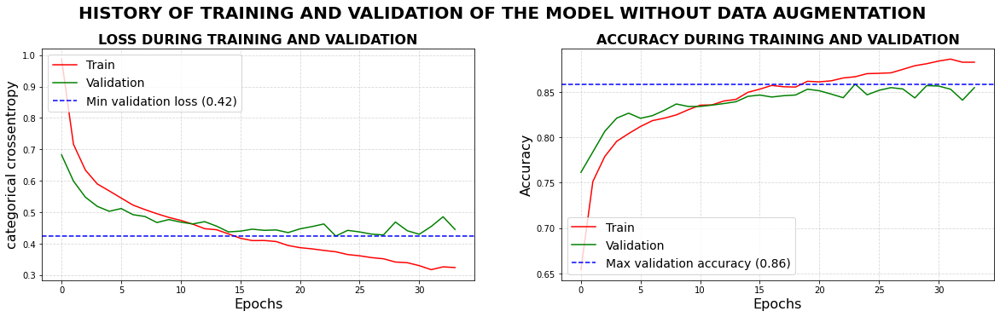

In [60]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
min_loss = min(history.history['val_loss'])
max_acc = max(history.history['val_accuracy'])

fig.suptitle("HISTORY OF TRAINING AND VALIDATION OF THE MODEL WITHOUT DATA AUGMENTATION", fontsize=20, fontweight='bold', y=1.02)
ax[0].set_title("LOSS DURING TRAINING AND VALIDATION", fontdict={'size': 16, 'weight': 'bold'})
ax[0].set_ylabel('categorical crossentropy', fontdict={'size': 16})
ax[0].grid(ls='--', alpha=0.5)
ax[0].set_xlabel('Epochs', fontdict={'size': 16})
ax[0].plot(history.history['loss'], c='r', label='Train')
ax[0].plot(history.history['val_loss'], c='g', label='Validation')
ax[0].axhline(y=min_loss, ls='--', c='blue', lw=1.5)
ax[0].plot(
    [], ls='--', c='blue', lw=1.5, 
    label=f"Min validation loss ({min_loss:.2f})"
)

ax[1].set_title("ACCURACY DURING TRAINING AND VALIDATION", fontdict={'size': 16, 'weight': 'bold'})
ax[1].set_ylabel('Accuracy', fontdict={'size': 16})
ax[1].set_xlabel('Epochs', fontdict={'size': 16})
ax[1].grid(ls='--', alpha=0.5)
ax[1].plot(history.history['accuracy'], c='r', label='Train')
ax[1].plot(history.history['val_accuracy'], c='g', label='Validation')
ax[1].axhline(y=max_acc, ls='--', c='blue', lw=1.5)
ax[1].plot(
    [], ls='--', c='blue', lw=1.5, 
    label=f"Max validation accuracy ({max_acc:.2f})"
)

ax[0].legend(loc='upper left', fontsize=14)
ax[1].legend(loc='lower left', fontsize=14)

plt.savefig(
    f"{results_path}/train-history.png", transparent=False,
    bbox_inches='tight', pad_inches=0.1
)
plt.savefig(
    f"{results_path}/train-history.pdf", transparent=False, 
    bbox_inches='tight', pad_inches=0.1
)

In [124]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2647), started 0:02:10 ago. (Use '!kill 2647' to kill it.)

<IPython.core.display.Javascript object>

In [61]:
y_pred = model.predict(X_test)
pred = np.argmax(y_pred, axis=1)
true = np.argmax(y_test, axis=1)

print(smetrics.classification_report(true, pred))

              precision    recall  f1-score   support

           0       0.86      0.90      0.88       429
           1       0.93      0.91      0.92       430
           2       0.82      0.89      0.86       450
           3       0.76      0.70      0.73       353
           4       0.96      0.90      0.93       363
           5       0.76      0.79      0.77       297
           6       0.81      0.72      0.76       388
           7       0.92      0.96      0.94       456
           8       0.77      0.75      0.76       378
           9       0.94      0.97      0.95       506

    accuracy                           0.86      4050
   macro avg       0.85      0.85      0.85      4050
weighted avg       0.86      0.86      0.86      4050



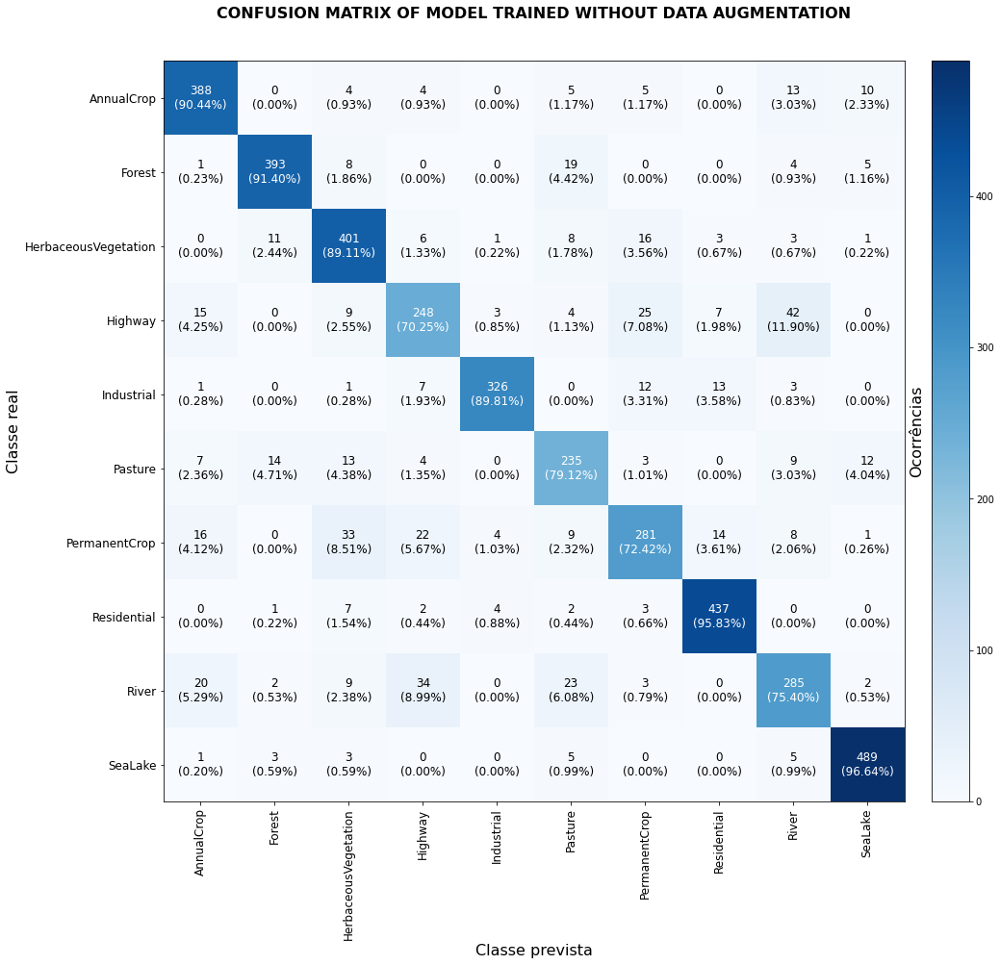

In [89]:
cm = smetrics.confusion_matrix(true, pred)

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.4)

total_samples = cm.sum(axis=1)[:, np.newaxis]
normed_conf_mat = cm.astype('float')/total_samples
labels = (
    'AnnualCrop',
    'Forest',
    'HerbaceousVegetation',
    'Highway',
    'Industrial',
    'Pasture',
    'PermanentCrop',
    'Residential',
    'River',
    'SeaLake'
)
label_font = dict(fontweight='normal', size=16)
title_font = dict(fontweight='bold', size=16)

matshow = ax.matshow(cm, cmap='Blues')
cb = plt.colorbar(matshow, cax=cax, orientation='vertical')

for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        cell_text = str(cm[i, j])
        cell_text += '\n(%.2f%%)' % (normed_conf_mat[i, j] * 100)
        ax.text(x=j,
                y=i,
                s=cell_text,
                size=12,
                va='center',
                ha='center',
                color="white" if normed_conf_mat[i, j] > 0.5 else "black")

ax.set_xticks(np.arange(10))
ax.set_xticklabels(labels, rotation=90, fontsize=12)

ax.set_yticks(np.arange(10))
ax.set_yticklabels(labels, fontsize=12)

ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

ax.set_xlabel('Classe prevista', fontdict=label_font)
ax.set_ylabel('Classe real', fontdict=label_font)
cb.ax.set_ylabel('Ocorrências', va='center', rotation=-270, labelpad=-80, fontsize=16)
ax.set_title('CONFUSION MATRIX OF MODEL TRAINED WITHOUT DATA AUGMENTATION', 
             fontdict=title_font)

plt.savefig(f"{results_path}/confusion_matrix_model.png", dpi=100, \
           bbox_inches='tight', transparent=False, pad_inches=0.1)

In [101]:
loss = 'categorical_crossentropy'
opt = tf.keras.optimizers.Adam(learning_rate=1e-3)
metrics = ['accuracy']

model_DA.compile(loss=loss, optimizer=opt, metrics=metrics)

log_dir_DA = f"{PATH}/logs/models_DA/vgg19/tensorboard"
ckp_dir_DA = f"{PATH}/logs/models_DA/vgg19/checkpoints"
if not os.path.exists(log_dir_DA): os.makedirs(log_dir_DA)
if not os.path.exists(ckp_dir_DA): os.makedirs(ckp_dir_DA)
callbacks_DA = [
    tf.keras.callbacks.TensorBoard(log_dir=log_dir_DA, histogram_freq=1),
    tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, 
                                     restore_best_weights=True),
    tf.keras.callbacks.ModelCheckpoint(
        f"{ckp_dir_DA}/vgg19-{{epoch:02d}}-{{val_accuracy:.2f}}.hdf5", 
        monitor='val_acc', verbose=1, save_best_only=True, mode='max'
    )
]

In [102]:
X_train_DA.shape, y_train_DA.shape, X_val_DA.shape, y_val_DA.shape

((20286, 64, 64, 3), (20286, 10), (4367, 64, 64, 3), (4367, 10))

In [103]:
with tf.device('GPU'):
    history_DA = model_DA.fit(
        X_train_DA, y_train_DA, epochs=100, batch_size=64, 
        validation_data=(X_val_DA, y_val_DA),
        callbacks=callbacks_DA, verbose=1
    )

Epoch 1/100
317/317 [==============================] - 27s 82ms/step - loss: 0.9792 - accuracy: 0.6550 - val_loss: 0.7045 - val_accuracy: 0.7495
Epoch 2/100
317/317 [==============================] - 23s 73ms/step - loss: 0.7365 - accuracy: 0.7423 - val_loss: 0.5974 - val_accuracy: 0.7866
Epoch 3/100
317/317 [==============================] - 23s 73ms/step - loss: 0.6616 - accuracy: 0.7716 - val_loss: 0.5789 - val_accuracy: 0.7992
Epoch 4/100
317/317 [==============================] - 24s 77ms/step - loss: 0.6174 - accuracy: 0.7876 - val_loss: 0.5590 - val_accuracy: 0.8088
Epoch 5/100
317/317 [==============================] - 24s 77ms/step - loss: 0.5922 - accuracy: 0.7970 - val_loss: 0.5306 - val_accuracy: 0.8186
Epoch 6/100
317/317 [==============================] - 23s 73ms/step - loss: 0.5639 - accuracy: 0.8016 - val_loss: 0.5052 - val_accuracy: 0.8196
Epoch 7/100
317/317 [==============================] - 23s 73ms/step - loss: 0.5430 - accuracy: 0.8132 - val_loss: 0.4922 - val_ac

In [107]:
model_DA.save(f"{results_path}/model_DA-vgg19.h5")
with open(f"{results_path}/history-model_DA-vgg19.pkl", 'wb') as handle:
    pickle.dump(history_DA.history, handle, protocol=pickle.HIGHEST_PROTOCOL)

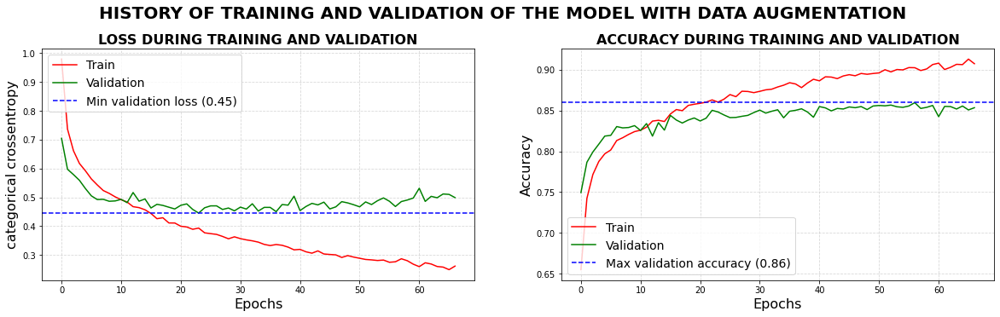

In [108]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
min_loss = min(history_DA.history['val_loss'])
max_acc = max(history_DA.history['val_accuracy'])

fig.suptitle("HISTORY OF TRAINING AND VALIDATION OF THE MODEL WITH DATA AUGMENTATION", fontsize=20, fontweight='bold', y=1.02)
ax[0].set_title("LOSS DURING TRAINING AND VALIDATION", fontdict={'size': 16, 'weight': 'bold'})
ax[0].set_ylabel('categorical crossentropy', fontdict={'size': 16})
ax[0].grid(ls='--', alpha=0.5)
ax[0].set_xlabel('Epochs', fontdict={'size': 16})
ax[0].plot(history_DA.history['loss'], c='r', label='Train')
ax[0].plot(history_DA.history['val_loss'], c='g', label='Validation')
ax[0].axhline(y=min_loss, ls='--', c='blue', lw=1.5)
ax[0].plot(
    [], ls='--', c='blue', lw=1.5, 
    label=f"Min validation loss ({min_loss:.2f})"
)

ax[1].set_title("ACCURACY DURING TRAINING AND VALIDATION", fontdict={'size': 16, 'weight': 'bold'})
ax[1].set_ylabel('Accuracy', fontdict={'size': 16})
ax[1].set_xlabel('Epochs', fontdict={'size': 16})
ax[1].grid(ls='--', alpha=0.5)
ax[1].plot(history_DA.history['accuracy'], c='r', label='Train')
ax[1].plot(history_DA.history['val_accuracy'], c='g', label='Validation')
ax[1].axhline(y=max_acc, ls='--', c='blue', lw=1.5)
ax[1].plot(
    [], ls='--', c='blue', lw=1.5, 
    label=f"Max validation accuracy ({max_acc:.2f})"
)

ax[0].legend(loc='upper left', fontsize=14)
ax[1].legend(loc='lower left', fontsize=14)

plt.savefig(
    f"{results_path}/train_DA-history.png", transparent=False,
    bbox_inches='tight', pad_inches=0.1
)
plt.savefig(
    f"{results_path}/train_DA-history.pdf", transparent=False, 
    bbox_inches='tight', pad_inches=0.1
)

In [121]:
%load_ext tensorboard
%tensorboard --logdir {log_dir_DA}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [116]:
y_pred_DA = model_DA.predict(X_test)
pred_DA = np.argmax(y_pred_DA, axis=1)

print(smetrics.classification_report(true, pred_DA))

              precision    recall  f1-score   support

           0       0.89      0.87      0.88       429
           1       0.93      0.93      0.93       430
           2       0.85      0.84      0.84       450
           3       0.72      0.75      0.74       353
           4       0.92      0.93      0.92       363
           5       0.69      0.89      0.78       297
           6       0.85      0.73      0.78       388
           7       0.93      0.95      0.94       456
           8       0.80      0.72      0.75       378
           9       0.96      0.95      0.95       506

    accuracy                           0.86      4050
   macro avg       0.85      0.86      0.85      4050
weighted avg       0.86      0.86      0.86      4050



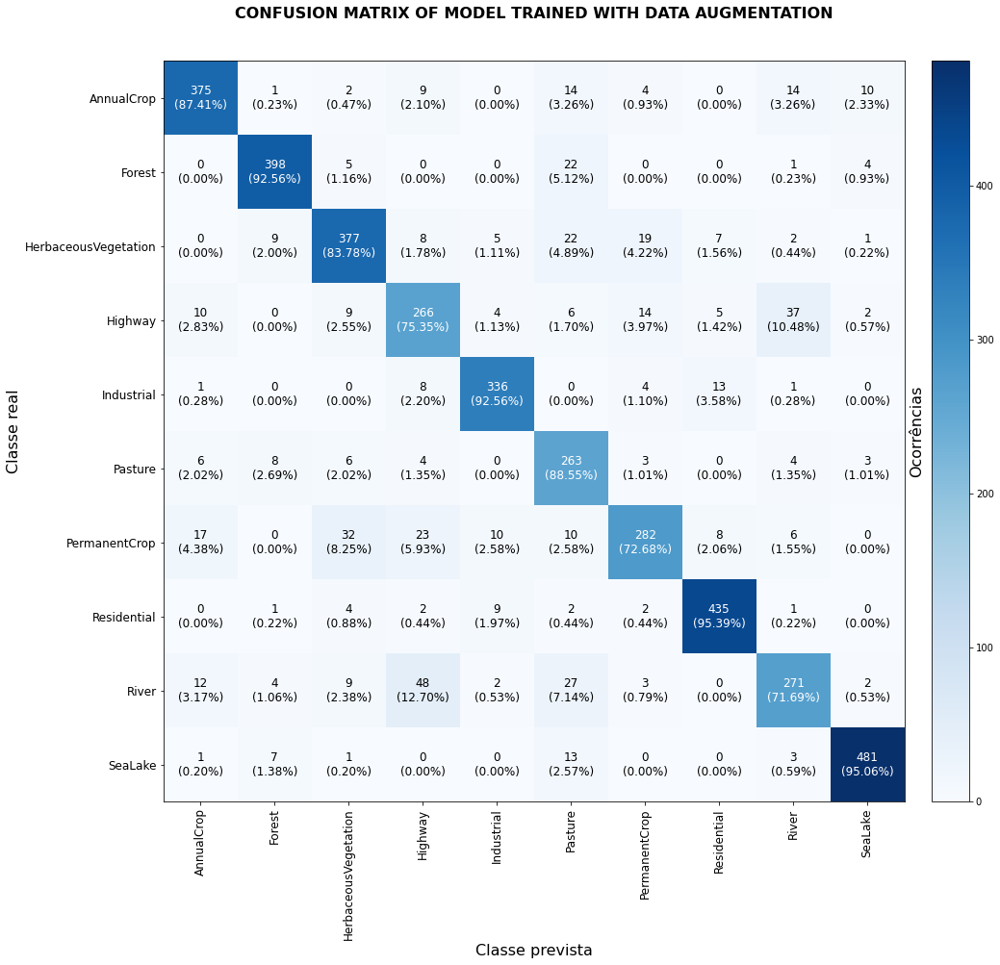

In [118]:
cm = smetrics.confusion_matrix(true, pred_DA)

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.4)

total_samples = cm.sum(axis=1)[:, np.newaxis]
normed_conf_mat = cm.astype('float')/total_samples
labels = (
    'AnnualCrop',
    'Forest',
    'HerbaceousVegetation',
    'Highway',
    'Industrial',
    'Pasture',
    'PermanentCrop',
    'Residential',
    'River',
    'SeaLake'
)
label_font = dict(fontweight='normal', size=16)
title_font = dict(fontweight='bold', size=16)

matshow = ax.matshow(cm, cmap='Blues')
cb = plt.colorbar(matshow, cax=cax, orientation='vertical')

for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        cell_text = str(cm[i, j])
        cell_text += '\n(%.2f%%)' % (normed_conf_mat[i, j] * 100)
        ax.text(x=j,
                y=i,
                s=cell_text,
                size=12,
                va='center',
                ha='center',
                color="white" if normed_conf_mat[i, j] > 0.5 else "black")

ax.set_xticks(np.arange(10))
ax.set_xticklabels(labels, rotation=90, fontsize=12)

ax.set_yticks(np.arange(10))
ax.set_yticklabels(labels, fontsize=12)

ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

ax.set_xlabel('Classe prevista', fontdict=label_font)
ax.set_ylabel('Classe real', fontdict=label_font)
cb.ax.set_ylabel('Ocorrências', va='center', rotation=-270, labelpad=-80, fontsize=16)
ax.set_title('CONFUSION MATRIX OF MODEL TRAINED WITH DATA AUGMENTATION', 
             fontdict=title_font)

plt.savefig(f"{results_path}/confusion_matrix_model_DA.png", dpi=100, \
           bbox_inches='tight', transparent=False, pad_inches=0.1)

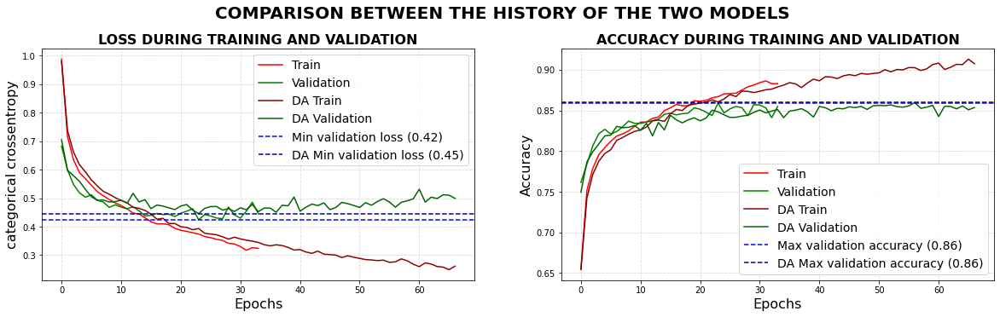

In [137]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))

fig.suptitle("COMPARISON BETWEEN THE HISTORY OF THE TWO MODELS", fontsize=20, fontweight='bold', y=1.02)
ax[0].set_title("LOSS DURING TRAINING AND VALIDATION", fontdict={'size': 16, 'weight': 'bold'})
ax[0].set_ylabel('categorical crossentropy', fontdict={'size': 16})
ax[0].grid(ls='--', alpha=0.5)
ax[0].set_xlabel('Epochs', fontdict={'size': 16})
ax[0].plot(history.history['loss'], c='r', label='Train')
ax[0].plot(history.history['val_loss'], c='g', label='Validation')

ax[0].plot(history_DA.history['loss'], c='darkred', ls='-', label='DA Train')
ax[0].plot(history_DA.history['val_loss'], c='darkgreen', ls='-', label='DA Validation')

min_loss = min(history.history['val_loss'])
ax[0].axhline(y=min_loss, ls='--', c='blue', lw=1.5)
ax[0].plot(
    [], c='blue', ls='--', lw=1.5, 
    label=f"Min validation loss ({min_loss:.2f})"
)

min_loss = min(history_DA.history['val_loss'])
ax[0].axhline(y=min_loss, ls='--', c='darkblue', lw=1.5)
ax[0].plot(
    [], ls='--', c='darkblue', lw=1.5, 
    label=f"DA Min validation loss ({min_loss:.2f})"
)


ax[1].set_title("ACCURACY DURING TRAINING AND VALIDATION", fontdict={'size': 16, 'weight': 'bold'})
ax[1].set_ylabel('Accuracy', fontdict={'size': 16})
ax[1].set_xlabel('Epochs', fontdict={'size': 16})
ax[1].grid(ls='--', alpha=0.5)
ax[1].plot(history.history['accuracy'], c='r', label='Train')
ax[1].plot(history.history['val_accuracy'], c='g', label='Validation')
ax[1].plot(history_DA.history['accuracy'], c='darkred', label='DA Train')
ax[1].plot(history_DA.history['val_accuracy'], c='darkgreen', label='DA Validation')

max_acc = max(history.history['val_accuracy'])
ax[1].axhline(y=max_acc, ls='--', c='blue', lw=1.5)
ax[1].plot(
    [], ls='--', c='blue', lw=1.5, 
    label=f"Max validation accuracy ({max_acc:.2f})"
)

max_acc = max(history_DA.history['val_accuracy'])
ax[1].axhline(y=max_acc, ls='--', c='darkblue', lw=1.5)
ax[1].plot(
    [], ls='--', c='darkblue', lw=1.5, 
    label=f"DA Max validation accuracy ({max_acc:.2f})"
)

ax[0].legend(loc='upper right', fontsize=14)
ax[1].legend(loc='lower right', fontsize=14)

plt.savefig(
    f"{results_path}/train_comp-history.png", transparent=False,
    bbox_inches='tight', pad_inches=0.1
)
plt.savefig(
    f"{results_path}/train_comp-history.pdf", transparent=False, 
    bbox_inches='tight', pad_inches=0.1
)

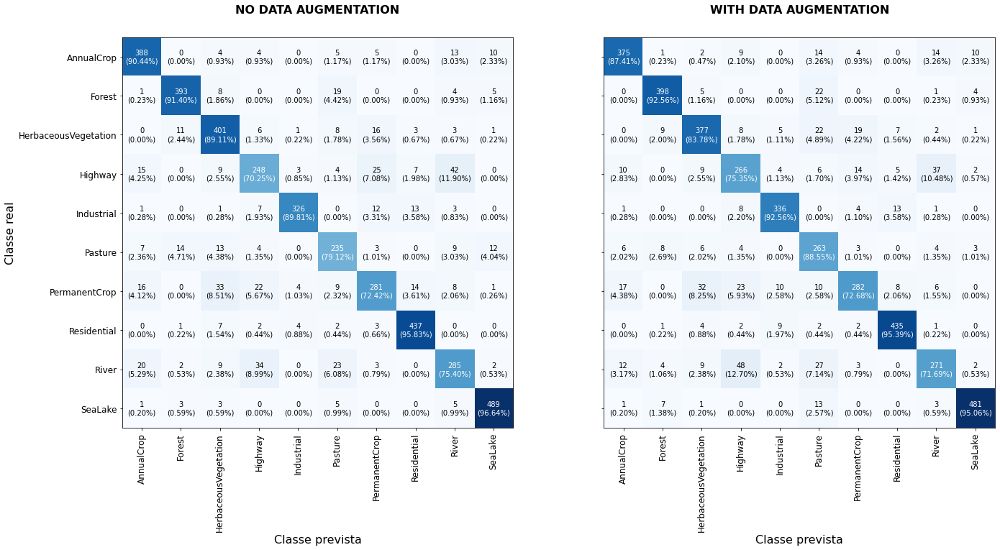

In [147]:
fig, (ax, ax2) = plt.subplots(1, 2, figsize=(22, 10), sharey=True)

total_samples = cm.sum(axis=1)[:, np.newaxis]
labels = (
    'AnnualCrop',
    'Forest',
    'HerbaceousVegetation',
    'Highway',
    'Industrial',
    'Pasture',
    'PermanentCrop',
    'Residential',
    'River',
    'SeaLake'
)
label_font = dict(fontweight='normal', size=16)
title_font = dict(fontweight='bold', size=16)

cm = smetrics.confusion_matrix(true, pred)
matshow = ax.matshow(cm, cmap='Blues')
normed_conf_mat = cm.astype('float')/total_samples
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        cell_text = str(cm[i, j])
        cell_text += '\n(%.2f%%)' % (normed_conf_mat[i, j] * 100)
        ax.text(x=j,
                y=i,
                s=cell_text,
                size=10,
                va='center',
                ha='center',
                color="white" if normed_conf_mat[i, j] > 0.5 else "black")

ax.set_xticks(np.arange(10))
ax.set_xticklabels(labels, rotation=90, fontsize=12)

ax.set_yticks(np.arange(10))
ax.set_yticklabels(labels, fontsize=12)

ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

ax.set_xlabel('Classe prevista', fontdict=label_font)
ax.set_ylabel('Classe real', fontdict=label_font)
cb.ax.set_ylabel('Ocorrências', va='center', rotation=-270, labelpad=-80, fontsize=16)
ax.set_title('NO DATA AUGMENTATION', 
             fontdict=title_font)


# With data augmentation
cm = smetrics.confusion_matrix(true, pred_DA)
matshow = ax2.matshow(cm, cmap='Blues')
normed_conf_mat = cm.astype('float')/total_samples
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        cell_text = str(cm[i, j])
        cell_text += '\n(%.2f%%)' % (normed_conf_mat[i, j] * 100)
        ax2.text(x=j,
                y=i,
                s=cell_text,
                size=10,
                va='center',
                ha='center',
                color="white" if normed_conf_mat[i, j] > 0.5 else "black")

ax2.set_xticks(np.arange(10))
ax2.set_xticklabels(labels, rotation=90, fontsize=12)

ax2.set_yticks(np.arange(10))
ax2.set_yticklabels(labels, fontsize=12)


ax2.xaxis.set_ticks_position('bottom')

ax2.set_xlabel('Classe prevista', fontdict=label_font)
ax2.set_title('WITH DATA AUGMENTATION', 
             fontdict=title_font)

plt.savefig(f"{results_path}/confusion_matrix_model_comp.png", dpi=100, \
           bbox_inches='tight', transparent=False, pad_inches=0.1)